# Unit 5 - Financial Planning


In [37]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [38]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [39]:
# Set current amount of crypto assets
my_btc = 1.2
my_eth = 5.3

In [40]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=CAD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=CAD"

In [41]:
# Fetch current BTC price
import json
btc_res = requests.get(btc_url)
btc_res.content
btc_data = btc_res.json()

btc_json_data = json.dumps(btc_data)

# print(btc_json_data)

btc_df = pd.DataFrame(btc_data['data']['1'])
btc_df
drop_columns = ['id', 'name', 'symbol', 'website_slug', 'rank', 'circulating_supply', 'total_supply', 'max_supply', 'last_updated']
btc_price_df = btc_df.drop(columns=drop_columns)

btc_price = btc_price_df.iloc[1][0]
btc_price = btc_price['price']

# Fetch current ETH price
eth_res = requests.get(eth_url)
eth_res.content
eth_data = eth_res.json()

eth_json_data = json.dumps(eth_data)

# print(eth_json_data)

eth_df = pd.DataFrame(eth_data['data']['1027'])
eth_df
drop_columns = ['id', 'name', 'symbol', 'website_slug', 'rank', 'circulating_supply', 'total_supply', 'max_supply', 'last_updated']
eth_price_df = eth_df.drop(columns=drop_columns)

eth_price = eth_price_df.iloc[1][0]
eth_price = eth_price['price']

print(f" BTC = ${btc_price:0.2f}")
print(f" ETH = ${eth_price:0.2f}")

# Compute current value of my crpto
my_btc_value = (btc_price * my_btc)
my_eth_value = (eth_price * my_eth)

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${my_btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${my_eth_value:0.2f}")

 BTC = $11383.04
 ETH = $377.19
The current value of your 1.2 BTC is $13659.65
The current value of your 5.3 ETH is $1999.11


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [42]:
# Current amount of shares
my_agg = 200
my_spy = 50

In [43]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version = "v2"
)

In [44]:
# Format current date as ISO format
start_date = pd.Timestamp("2017-10-11", tz="America/New_York").isoformat()
end_date = pd.Timestamp("2020-10-11", tz="America/New_York").isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
df_ticker = api.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date).df
# Preview DataFrame
df_ticker.tail()

AGG                                        \
                             open    high       low    close     volume   
2020-10-05 00:00:00-04:00  117.74  117.74  117.5200  117.520  4347016.0   
2020-10-06 00:00:00-04:00  117.60  117.84  117.4900  117.610  3973998.0   
2020-10-07 00:00:00-04:00  117.53  117.66  117.4515  117.530  3867168.0   
2020-10-08 00:00:00-04:00  117.67  117.71  117.5900  117.690  3580248.0   
2020-10-09 00:00:00-04:00  117.65  117.74  117.5000  117.705  2750029.0   

                              SPY                                    
                             open    high     low   close    volume  
2020-10-05 00:00:00-04:00  336.06  339.96  336.01  339.73  38540997  
2020-10-06 00:00:00-04:00  339.92  342.17  334.38  334.94  74231873  
2020-10-07 00:00:00-04:00  338.12  341.63  338.09  340.73  40579189  
2020-10-08 00:00:00-04:00  342.85  343.85  341.86  343.73  35858727  
2020-10-09 00:00:00-04:00  345.56  347.35  344.89  346.84  45969566

In [45]:
# Pick AGG and SPY close prices
agg_close_price = df_ticker['AGG']['close'][-1]
spy_close_price = df_ticker['SPY']['close'][-1]

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price:0.2f}")
print(f"Current SPY closing price: ${spy_close_price:0.2f}")


Current AGG closing price: $117.70
Current SPY closing price: $346.84


In [46]:
# Compute the current value of shares

my_agg_value = (my_spy) * (agg_close_price)

my_spy_value = (my_agg) * (spy_close_price)

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $69368.00
The current value of your 200 AGG shares is $5885.25


### Savings Health Analysis

In [47]:
# Set monthly household income
monthly_income = 12000

# Create savings DataFrame
share_value = (my_agg_value + my_spy_value)
crypto_value = (my_btc_value + my_eth_value)
data = {'assets':["crypto", 'shares'],'amount':[crypto_value, share_value]}

df_savings = pd.DataFrame(data)

# Display savings DataFrame

df_savings.set_index('assets', inplace=True)
df_savings

,amount
assets,
crypto,15658.755
shares,75253.250


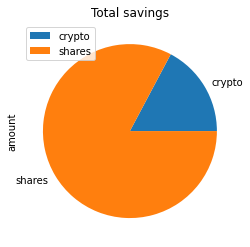

In [48]:
# plot pie chart of asset value
plot = df_savings.plot.pie(y='amount', title="Total savings")


In [49]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3
total_savings = crypto_value + share_value
shortage = emergency_fund - total_savings

# Calculate total amount of savings
print(f" Your emergency fund = ${total_savings:0.2f}")

# Validate saving health
if total_savings > emergency_fund:
    print('You are in good shape!')
elif total_savings == emergency_fund:
    print("Congrats on reaching your emergency fund goal!")
else:
    print(f"You need ${shortage:0.2f} to meet emergency fund goal.")

 Your emergency fund = $90912.01
You are in good shape!


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [50]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-10-11', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-10-11', tz='America/New_York').isoformat()

In [56]:
# Get 5 years' worth of historical data for SPY and AGG
tickers = ["AGG", "SPY"]
timeframe = "1D"
df_stock_data = api.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date).df
# Display sample data
df_stock_data.tail()

AGG                                        \
                             open    high       low    close     volume   
2020-10-05 00:00:00-04:00  117.74  117.74  117.5200  117.520  4347016.0   
2020-10-06 00:00:00-04:00  117.60  117.84  117.4900  117.610  3973998.0   
2020-10-07 00:00:00-04:00  117.53  117.66  117.4515  117.530  3867168.0   
2020-10-08 00:00:00-04:00  117.67  117.71  117.5900  117.690  3580248.0   
2020-10-09 00:00:00-04:00  117.65  117.74  117.5000  117.705  2750029.0   

                              SPY                                    
                             open    high     low   close    volume  
2020-10-05 00:00:00-04:00  336.06  339.96  336.01  339.73  38540997  
2020-10-06 00:00:00-04:00  339.92  342.17  334.38  334.94  74231873  
2020-10-07 00:00:00-04:00  338.12  341.63  338.09  340.73  40579189  
2020-10-08 00:00:00-04:00  342.85  343.85  341.86  343.73  35858727  
2020-10-09 00:00:00-04:00  345.56  347.35  344.89  346.84  45969566

In [52]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
MC_df_stock_data = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [.40, .60],
    num_simulation = 500,
    num_trading_days = 252*30
)

In [57]:
# Printing the simulation input data
MC_df_stock_data.portfolio_data.tail()

AGG                                        \
                             open    high       low    close     volume   
2020-10-05 00:00:00-04:00  117.74  117.74  117.5200  117.520  4347016.0   
2020-10-06 00:00:00-04:00  117.60  117.84  117.4900  117.610  3973998.0   
2020-10-07 00:00:00-04:00  117.53  117.66  117.4515  117.530  3867168.0   
2020-10-08 00:00:00-04:00  117.67  117.71  117.5900  117.690  3580248.0   
2020-10-09 00:00:00-04:00  117.65  117.74  117.5000  117.705  2750029.0   

                                           SPY                          \
                          daily_return    open    high     low   close   
2020-10-05 00:00:00-04:00    -0.003392  336.06  339.96  336.01  339.73   
2020-10-06 00:00:00-04:00     0.000766  339.92  342.17  334.38  334.94   
2020-10-07 00:00:00-04:00    -0.000680  338.12  341.63  338.09  340.73   
2020-10-08 00:00:00-04:00     0.001361  342.85  343.85  341.86  343.73   
2020-10-09 00:00:00-04:00     0.000127  345.56  347.35  344.89  346.84   

                                                  
                             volume daily_return  
2020-10-05 00:00:00-04:00  38540997     0.017552  
2020-10-06 00:00:00-04:00  74231873    -0.014099  
2020-10-07 00:00:00-04:00  40579189     0.017287  
2020-10-08 00:00:00-04:00  35858727     0.008805  
2020-10-09 00:00:00-04:00  45969566     0.009048

In [74]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
MC_df_stock_data.calc_cumulative_return().T

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,7551,7552,7553,7554,7555,7556,7557,7558,7559,7560
0,1.0,0.997771,0.999415,1.006726,0.999103,1.004392,0.996011,0.989004,0.987265,0.991765,...,7.773440,7.753439,7.771871,7.871917,7.821085,7.753520,7.775663,7.659906,7.670783,7.720484
1,1.0,1.001636,1.002648,0.997961,1.001824,0.991953,0.980845,0.986686,0.993956,0.998154,...,39.172968,38.967731,38.553500,39.010018,38.839806,39.183785,39.397182,39.283878,39.420344,39.178859
2,1.0,1.000198,0.999451,0.990854,0.999511,1.004027,0.994344,0.978645,0.991735,0.998900,...,7.547063,7.553961,7.479714,7.392258,7.432111,7.388907,7.414731,7.411041,7.372729,7.361222
3,1.0,1.000545,0.998940,0.998036,0.996180,1.001649,1.001875,1.001553,0.998530,1.014434,...,8.146589,8.121077,8.170997,8.220414,8.205809,8.181166,8.209150,8.209394,8.199899,8.226654
4,1.0,0.983399,0.992412,0.996002,0.993338,0.998146,1.001609,1.003892,1.008911,1.016347,...,3.678279,3.681957,3.663011,3.652888,3.676392,3.655188,3.687773,3.684240,3.654760,3.652628
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,1.0,1.001014,1.009353,1.018863,1.001459,0.996057,0.977675,0.978426,0.981730,0.990845,...,4.223188,4.230029,4.193638,4.224343,4.196722,4.169714,4.173961,4.190980,4.191163,4.207972
496,1.0,0.992845,0.997365,0.981858,0.994319,0.994066,0.991358,0.992073,0.989946,0.973103,...,5.162933,5.132912,5.148202,5.200005,5.196394,5.153240,5.142532,5.090523,5.092929,5.073112
497,1.0,1.001196,1.005977,1.009293,1.010133,1.012377,0.999002,0.999003,1.002884,0.993819,...,14.388829,14.443200,14.302204,14.278903,14.188253,14.126350,14.155390,14.063420,13.968632,13.898230
498,1.0,1.001003,0.995053,1.010666,1.018099,1.014974,1.005397,0.998420,0.997805,0.990332,...,3.436425,3.422017,3.462415,3.451716,3.434773,3.457737,3.459991,3.437689,3.427447,3.461484


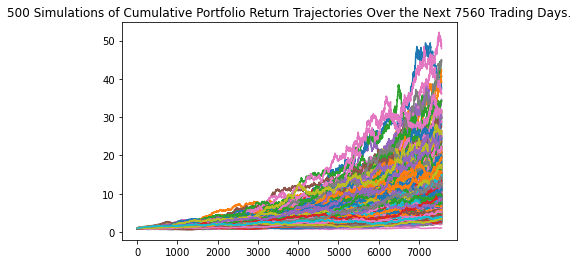

In [75]:
# Plot simulation outcomes
line_plot = MC_df_stock_data.plot_simulation()

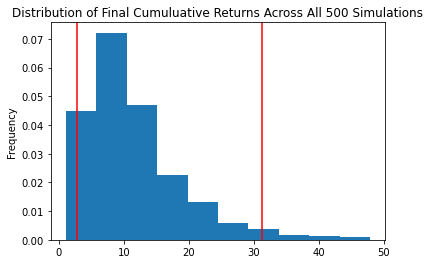

In [76]:
# Plot probability distribution and confidence intervals
dist_plot = MC_df_stock_data.plot_distribution()

### Retirement Analysis

In [77]:
# Fetch summary statistics from the Monte Carlo simulation results
portfolio_sim_summary = MC_df_stock_data.summarize_cumulative_return()

# Print summary statistics
print(portfolio_sim_summary)

count           500.000000
mean             11.465207
std               7.439394
min               1.064630
25%               6.563009
50%               9.488455
75%              14.257619
max              47.928869
95% CI Lower      2.757735
95% CI Upper     31.277742
Name: 7560, dtype: float64


### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [78]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
portfolio_ci_lower = round(portfolio_sim_summary[8]*20000,2)
portfolio_ci_upper = round(portfolio_sim_summary[9]*20000,2)


# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment:0.2f} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${portfolio_ci_lower:0.2f} and ${portfolio_ci_upper:0.2f}")

There is a 95% chance that an initial investment of $20000.00 in the portfolio over the next 30 years will end within in the range of $55154.69 and $625554.85


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [79]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000

portfolio_ci_lower = round(portfolio_sim_summary[8]*(initial_investment))
portfolio_ci_upper = round(portfolio_sim_summary[9]*(initial_investment))

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment:0.2f} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${portfolio_ci_lower:0.2f} and ${portfolio_ci_upper:0.2f}")

There is a 95% chance that an initial investment of $30000.00 in the portfolio over the next 30 years will end within in the range of $82732.00 and $938332.00


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [63]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [64]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [65]:
# Plot simulation outcomes
# YOUR CODE HERE!

In [66]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [67]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

In [68]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

NameError: name 'ci_lower_five' is not defined

### Ten Years Retirement Option

In [54]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [55]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [56]:
# Plot simulation outcomes
# YOUR CODE HERE!

In [57]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [58]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

In [59]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

NameError: name 'ci_lower_ten' is not defined